In [1]:
# reloads all sourced file before running called functions; avoids having to restart kernel for every modification
%load_ext autoreload
%autoreload 2

In [2]:
PATH = ''

In [1]:
from tqdm import tqdm
from functools import partial
import os
import sys
sys.path.append('../')

import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
sns.set_style('whitegrid')
from scipy.stats import gamma, pareto, t, norm, chi2, uniform, invgamma
from scipy.ndimage import uniform_filter
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from statsmodels.nonparametric.kernel_regression import KernelReg
from xgboost import XGBRegressor

from power_utils import pareto_neg_ll, fisher_info, norm_neg_ll, t_neg_ll, ParetoShape, TStudentLocation, TStudentLocationVaryingDoF, GaussianMean, power_neyman, critical_values_mc
from gmm_utils import plot_1D_cutoffs, plot_1D_statistics, plot_1D_statistics_cutoffs
from toy_mvn_multid_isotropic import ToyMVG
from qr_algorithms.complete_list import classifier_cde_dict
from qr_utils.qr_functions import train_qr_algo

/Users/luca/miniforge3/envs/waldo/lib/python3.9/site-packages/jax/_src/lib/__init__.py:33: UserWarning: JAX on Mac ARM machines is experimental and minimally tested. Please see https://github.com/google/jax/issues/5501 in the event of problems.
  warnings.warn("JAX on Mac ARM machines is experimental and minimally tested. "


# Gaussian model with known $\sigma$, estimate $\mu$: $\underbrace{\mu \sim \mathcal{U}(a, b)}_{prior} \text{ or } \underbrace{\mu \sim \mathcal{N}(a, b)}_{prior}, \underbrace{x \sim \mathcal{N}(\mu, \sigma^2)}_{likelihood}$

In [45]:
true_mean = 40
true_sigma = 1

param_grid_bounds=(35, 45)
param_grid_size=500

observed_sample_size = 1
b = 20_000
b_prime = 20_000

confidence_level = 0.95

prior = 'uniform'
prior_kwargs={'loc': param_grid_bounds[0], 'scale': param_grid_bounds[1]-param_grid_bounds[0]}  #{'loc': 40, 'scale': 1} # 

### Likelihood

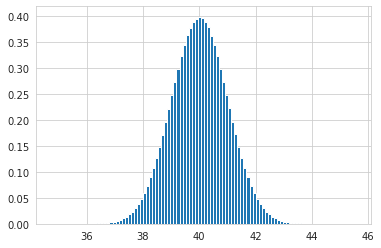

In [9]:
plt.hist(norm(loc=true_mean, scale=true_sigma).rvs(size=10_000_000), bins=100, density=True)
plt.show()

### Train Waldo - MLE method - Kernel Reg

##### Generate data

In [46]:
simulator = GaussianMean(param_grid_bounds=param_grid_bounds, param_grid_size=param_grid_size, 
                         likelihood_kwargs={'scale': true_sigma}, prior=prior, prior_kwargs=prior_kwargs, 
                         observed_sample_size=observed_sample_size, sample_method='mle')

In [47]:
b_sample_theta, b_sample_x = simulator.generate_sample(size=b)
b_prime_sample_theta, b_prime_sample_x = simulator.generate_sample(size=b_prime)

##### Conditional Mean

In [48]:
conditional_mean = KernelReg(endog=b_sample_theta, exog=b_sample_x.reshape(-1, ), var_type='c', reg_type='ll', bw=[6.87535428], ckertype='gaussian')
cond_mean_preds, _ = conditional_mean.fit(data_predict=b_sample_x.reshape(-1, ))

In [8]:
conditional_mean.bw

array([6.87535428])

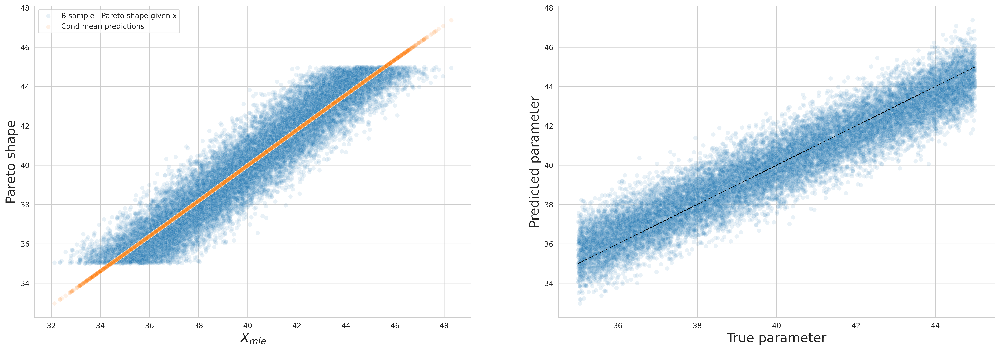

In [49]:
fig, ax = plt.subplots(1, 2, figsize=(24, 8))

sns.scatterplot(x=b_sample_x.reshape(-1, ), y=b_sample_theta, alpha=0.1, label="B sample - Pareto shape given x", ax=ax[0])
sns.scatterplot(x=b_sample_x.reshape(-1, ), y=cond_mean_preds, alpha=0.1, label="Cond mean predictions", ax=ax[0])
ax[0].set_xlabel(r"$X_{mle}$", fontsize=18)
ax[0].set_ylabel("Pareto shape", fontsize=18)

sns.scatterplot(x=b_sample_theta, y=cond_mean_preds, alpha=0.1)
ax[1].plot([np.min(b_sample_theta), np.max(b_sample_theta)], [np.min(b_sample_theta), np.max(b_sample_theta)], linestyle='--', linewidth=1, color='black', label="bisector")
ax[1].set_xlabel('True parameter', fontsize=18)
ax[1].set_ylabel('Predicted parameter', fontsize=18)
#ax[1].set_xlim(-.5, np.max(b_sample_theta))
#ax[1].set_ylim(-.5, np.max(b_sample_theta))
plt.show()

##### Conditional Variance

In [50]:
cond_var_response = ((b_sample_theta.reshape(-1,1) - cond_mean_preds.reshape(-1,1))**2).reshape(-1,)
assert cond_var_response.shape == (b_sample_theta.shape[0],), cond_var_response.shape

In [51]:
conditional_var = KernelReg(endog=cond_var_response, exog=b_sample_x.reshape(-1, ), var_type='c', reg_type='ll', bw=[2.36509284], ckertype='gaussian')
cond_var_preds, _ = conditional_var.fit(data_predict=b_sample_x.reshape(-1, ))

In [12]:
conditional_var.bw

array([2.36509284])

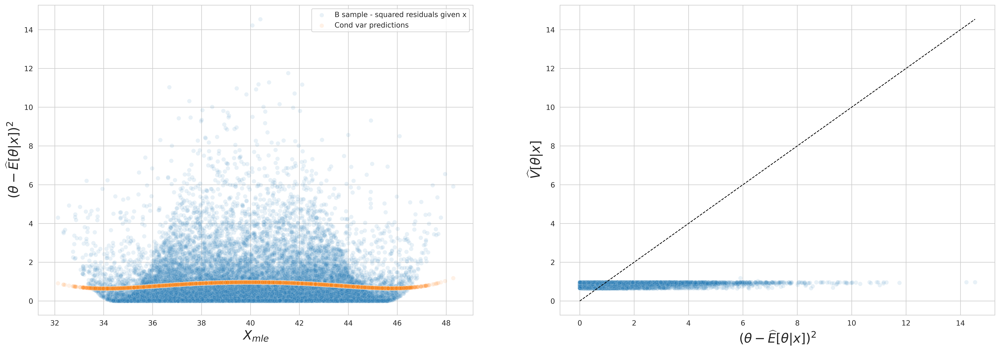

In [52]:
fig, ax = plt.subplots(1, 2, figsize=(24, 8))

sns.scatterplot(x=b_sample_x.reshape(-1, ), y=cond_var_response, alpha=0.1, label="B sample - squared residuals given x", ax=ax[0])
sns.scatterplot(x=b_sample_x.reshape(-1, ), y=cond_var_preds, alpha=0.1, label="Cond var predictions", ax=ax[0])
ax[0].set_xlabel(r"$X_{mle}$", fontsize=18)
ax[0].set_ylabel(r"$(\theta - \widehat{E}[\theta|x])^2$", fontsize=18)
# ax[0].set_ylim(-1, np.max(cond_var_preds))

sns.scatterplot(x=cond_var_response, y=cond_var_preds, alpha=0.1, ax=ax[1])
ax[1].plot([np.min(cond_var_response), np.max(cond_var_response)], [np.min(cond_var_response), np.max(cond_var_response)], 
           linestyle='--', linewidth=1, color='black', label="bisector")
ax[1].set_xlabel(r"$(\theta - \widehat{E}[\theta|x])^2$", fontsize=18)
ax[1].set_ylabel(r'$\widehat{V}[\theta|x]$', fontsize=18)
#ax[1].set_xlim(-5, np.max(cond_var_response))
# ax[1].set_ylim(-5, np.max(cond_var_response))
plt.show()

###### Compare with exact conditional variance

In [14]:
exact_conditional_var = simulator.exact_cond_var(sample=b_sample_x_raw, theta_support=None, posterior_samples=50_000)

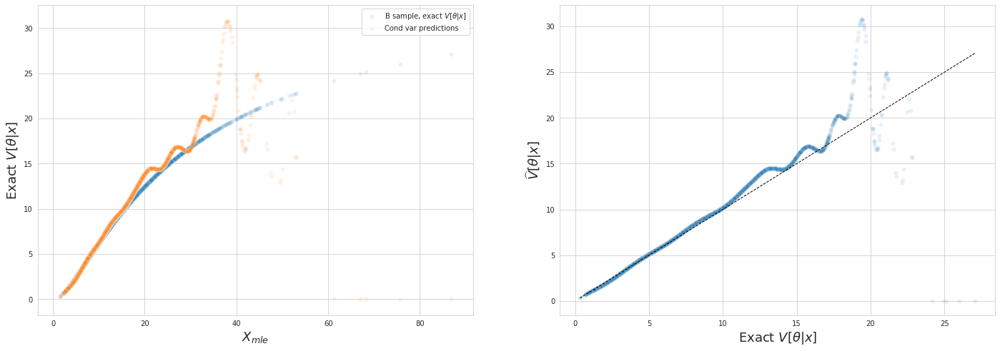

In [15]:
fig, ax = plt.subplots(1, 2, figsize=(24, 8))

sns.scatterplot(x=b_sample_x.reshape(-1, ), y=exact_conditional_var, alpha=0.1, label=r"B sample, exact $V[\theta|x]$", ax=ax[0])
sns.scatterplot(x=b_sample_x.reshape(-1, ), y=cond_var_preds, alpha=0.1, label="Cond var predictions", ax=ax[0])
ax[0].set_xlabel(r"$X_{mle}$", fontsize=18)
ax[0].set_ylabel(r'Exact $V[\theta|x]$', fontsize=18)
#ax[0].set_ylim(-0.1, 5)

sns.scatterplot(x=exact_conditional_var, y=cond_var_preds, alpha=0.1, ax=ax[1])
ax[1].plot([np.min(exact_conditional_var), np.max(exact_conditional_var)], [np.min(exact_conditional_var), np.max(exact_conditional_var)], 
           linestyle='--', linewidth=1, color='black', label="bisector")
ax[1].set_xlabel(r'Exact $V[\theta|x]$', fontsize=18)
ax[1].set_ylabel(r'$\widehat{V}[\theta|x]$', fontsize=18)
#ax[1].set_xlim(-5, np.max(exact_conditional_var))
#ax[1].set_ylim(-5, np.max(exact_conditional_var))
plt.show()

##### Quantile Regression

In [53]:
qr_conditional_means, _ = conditional_mean.fit(data_predict=b_prime_sample_x.reshape(-1, simulator.observed_d))
qr_conditional_vars, _ = conditional_var.fit(data_predict=b_prime_sample_x.reshape(-1, simulator.observed_d))

qr_statistics = ((qr_conditional_means.reshape(-1,1) - b_prime_sample_theta.reshape(-1,1))**2)/qr_conditional_vars.reshape(-1,1)
qr_statistics_novar = (qr_conditional_means.reshape(-1,1) - b_prime_sample_theta.reshape(-1,1))**2

###### XGB

In [54]:
learner_kwargs = {'max_depth': 1, 'n_estimators': 1000}
qr_XGB, predicted_lfi_cutoffs_95_xgb = train_qr_algo(model_obj=simulator, alpha=confidence_level,
                                                     theta_mat=b_prime_sample_theta, stats_mat=qr_statistics,
                                                     algo_name='xgb', learner_kwargs=learner_kwargs, pytorch_kwargs=None,
                                                     prediction_grid=np.concatenate((simulator.param_grid, np.array([true_mean]))))                                                        

"\nlearner_kwargs = {'max_depth': 1, 'n_estimators': 1000}\nqr_XGB_novar, predicted_lfi_cutoffs_95_xgb_novar = train_qr_algo(model_obj=simulator, alpha=confidence_level,\n                                                                 theta_mat=b_prime_sample_theta, stats_mat=qr_statistics_novar,\n                                                                 algo_name='xgb', learner_kwargs=learner_kwargs, pytorch_kwargs=None,\n                                                                 prediction_grid=np.concatenate((simulator.param_grid, np.array([true_shape]))))\n\nlearner_kwargs = {'max_depth': 1, 'n_estimators': 1000}\nqr_XGB_exact_var, predicted_lfi_cutoffs_95_xgb_exact_var = train_qr_algo(model_obj=simulator, alpha=confidence_level,\n                                                                         theta_mat=b_prime_sample_theta, stats_mat=qr_statistics_exact_var,\n                                                                         algo_name='xgb', learner_kw

### COMPUTE POWER

In [55]:
saved_cutoffs = critical_values_mc(simulator=simulator, 
                                   param_grid=np.concatenate((simulator.param_grid, np.array([true_mean]))), param_grid_size=simulator.param_grid_size+1,
                                   mc_n_draws=100_000,
                                   confidence_level=confidence_level,
                                   wald=True, exact_waldo=False, wald_restricted_size=1000)

Computing cutoffs for 501 tests via Monte Carlo: 501it [01:25,  5.83it/s]


In [58]:
power_neyman(n_draws=1000, simulator=simulator, true_param=true_mean, 
             cond_mean_predictor=conditional_mean, cond_var_predictor=conditional_var, algo_name='kernel_reg',
             waldo_cutoffs=predicted_lfi_cutoffs_95_xgb, waldo_cutoffs_novar=None, waldo_cutoffs_exact_var=None,
             confidence_level=confidence_level, mc_n_draws=100_000, 
             saved_cutoffs=saved_cutoffs, waldo=True, exact_waldo=False, wald=True, novar=False,
             run_name='LATEST_uniform', save_path=PATH)

Computing power for each observation: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 92.05it/s]

Computing power for estimated Waldo and Waldo-NOVAR...


Plotting...
Empty sets:  0
